In [1]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from mpl_toolkits.mplot3d import proj3d
from waymo_open_dataset.utils import  frame_utils
from waymo_open_dataset import dataset_pb2 as open_dataset

from lidar_compression.util.pointcloud_sort import add_spherical_coordinates, sort_points

2021-08-17 17:12:06.533480: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0


# Load One Cloud

In [2]:
dir = "/disk/vanishing_data/fa401/waymo/"
filename = "segment-10023947602400723454_1120_000_1140_000_with_camera_labels.tfrecord"
file = dir + filename
dataset = tf.data.TFRecordDataset(file)
for data in dataset:
    frame = open_dataset.Frame()
    frame.ParseFromString(bytearray(data.numpy()))
    break
(range_images, camera_projections,
    range_image_top_pose) = frame_utils.parse_range_image_and_camera_projection(frame)
points, cp_points = frame_utils.convert_range_image_to_point_cloud(
    frame,
    range_images,
    camera_projections,
    range_image_top_pose)
# 3d points in vehicle frame.
cloud = np.concatenate(points, axis=0)

2021-08-17 17:12:08.435175: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcuda.so.1
2021-08-17 17:12:08.449905: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-08-17 17:12:08.450323: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1733] Found device 0 with properties: 
pciBusID: 0000:01:00.0 name: NVIDIA GeForce RTX 2080 Ti computeCapability: 7.5
coreClock: 1.545GHz coreCount: 68 deviceMemorySize: 10.76GiB deviceMemoryBandwidth: 573.69GiB/s
2021-08-17 17:12:08.450339: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0
2021-08-17 17:12:08.451916: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcublas.so.11
2021-08-17 17:12:08.451942: I tensorflow/stream_executor

In [3]:
cartesian_spherical_cloud = add_spherical_coordinates(cloud)
sorted_cloud = sort_points(cartesian_spherical_cloud)

# Plot Cartesian

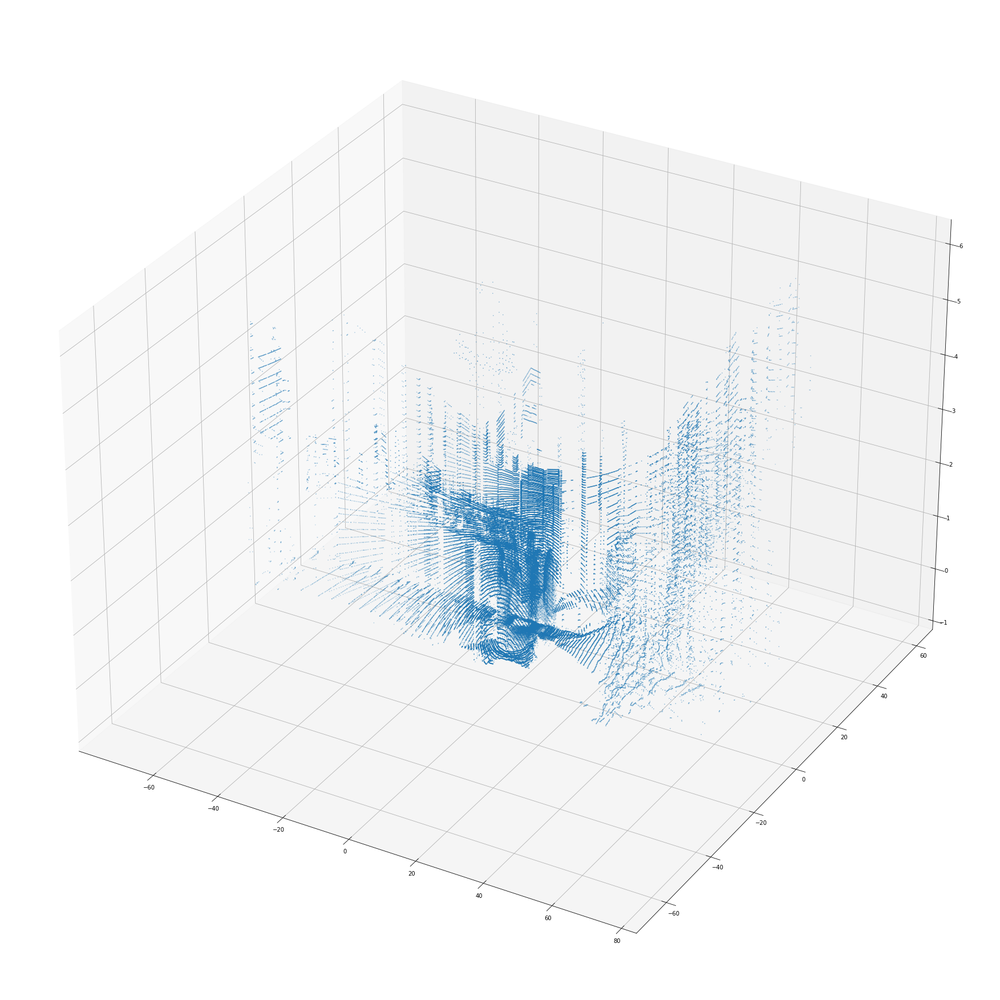

In [4]:
x = cartesian_spherical_cloud[:, 0]
y = cartesian_spherical_cloud[:, 1]
z = cartesian_spherical_cloud[:, 2]

fig = plt.figure(figsize=(32, 32))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(x, y, z, s=0.25)

plt.show()

# Plot Spherical Coordinates (by computing cartesian coordinates from the spherical ones)

In [5]:
# # r = cartesian_spherical_cloud[:, 3]
# # theta = cartesian_spherical_cloud[:, 4]
# # phi = cartesian_spherical_cloud[:, 5]
# 
# x_1 = cartesian_spherical_cloud[:, 3] * np.sin(cartesian_spherical_cloud[:, 4])
#   * np.cos(cartesian_spherical_cloud[:, 5])
# y_1 = cartesian_spherical_cloud[:, 3] * np.sin(cartesian_spherical_cloud[:, 4]) 
# * np.sin(cartesian_spherical_cloud[:, 5])
# z_1 = cartesian_spherical_cloud[:, 3] * np.cos(cartesian_spherical_cloud[:, 4])
# 
# fig = plt.figure(figsize=(32, 32))
# 
# ax = fig.add_subplot(111, projection='3d')
# ax.scatter(x_1, y_1, z_1, s=0.25)
# 
# plt.show()

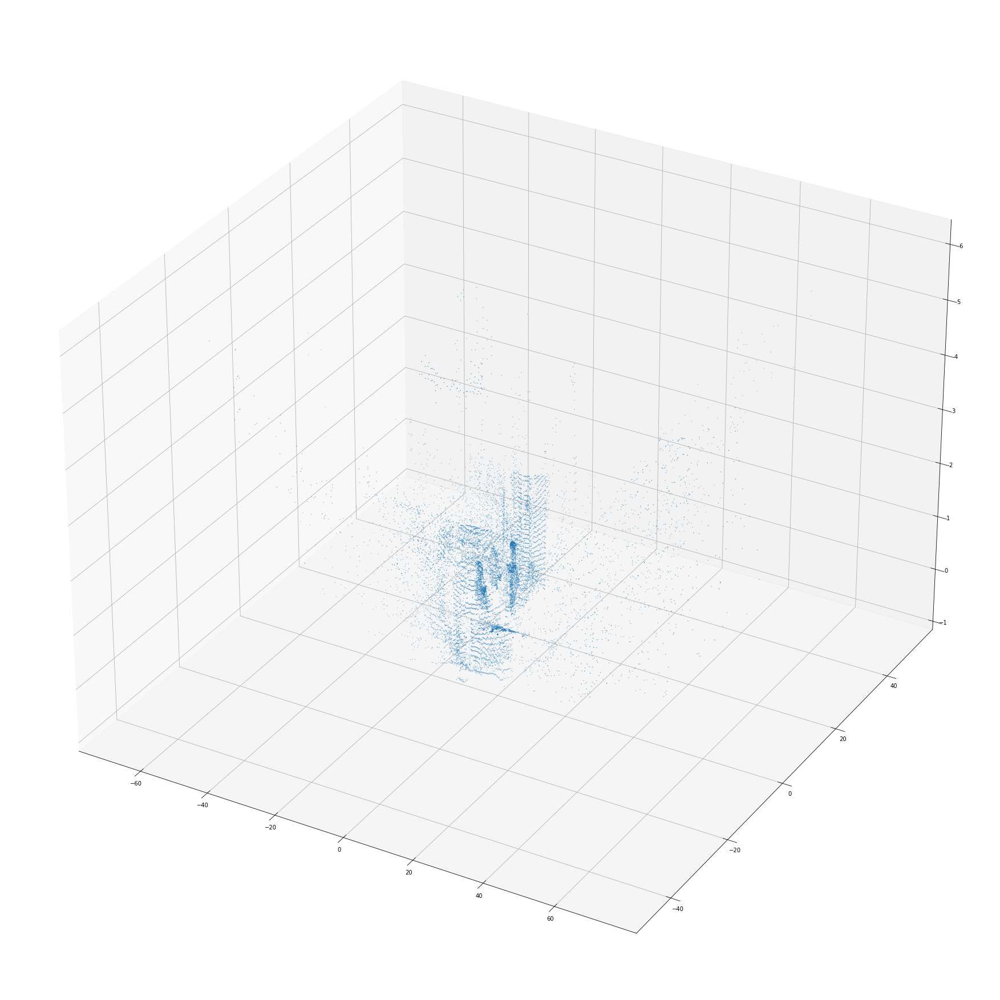

In [6]:
x = sorted_cloud[:,:,0]
y = sorted_cloud[:,:,1]
z = sorted_cloud[:,:,2]

fig = plt.figure(figsize=(32, 32))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(x, y, z, s=0.5)

plt.show()